In [2]:
import matplotlib.pyplot as plt
import plotly.graph_objs as go
import numpy as np
from pathlib import Path

home_dir = Path().home()
ml_data = home_dir / 'ml_data'
if not ml_data.exists():
    ml_data.mkdir()

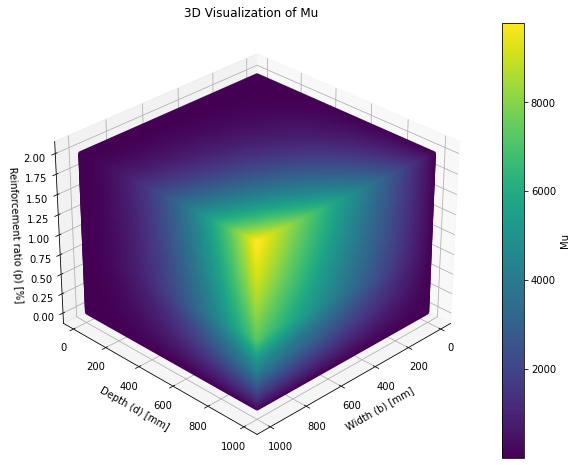

In [3]:
Design_space = np.load(ml_data / 'designspace_meshgrid_data.npz')
M_u = np.load(ml_data / 'Ana_TTC_M_u.npy')
rho_mesh, b_mesh, d_mesh = Design_space['rho_mesh'], Design_space['b_mesh'], Design_space['d_mesh']

Mu_values = M_u

p_flat = rho_mesh.flatten()
b_flat = b_mesh.flatten()
d_flat = d_mesh.flatten()
Mu_flat = Mu_values.flatten()
# Design_space = np.hstack((rho_mesh.flatten()[:, np.newaxis], b_mesh.flatten()[:, np.newaxis], d_mesh.flatten()[:, np.newaxis]))

fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
sc = ax.scatter(b_flat, d_flat, p_flat, c=Mu_flat, cmap='viridis')

cbar = fig.colorbar(sc)
cbar.set_label('Mu')

ax.set_xlabel('Width (b) [mm]')
ax.set_ylabel('Depth (d) [mm]')
ax.set_zlabel('Reinforcement ratio (p) [%]')
ax.set_title('3D Visualization of Mu')
ax.view_init(elev=30, azim=45)  # Adjust these values as needed

plt.show()


In [16]:
from plotly.subplots import make_subplots

# Load the data
Design_space = np.load(ml_data / 'designspace_meshgrid_data.npz')
M_u_ana = np.load(ml_data / 'Ana_TTC_M_u.npy')
M_u_aci = np.load(ml_data / 'ACI440_Mn.npy')
rho_mesh, b_mesh, d_mesh = Design_space['rho_mesh'], Design_space['b_mesh'], Design_space['d_mesh']

# Define step size for plotting
step_size = 5

# Create subplots: two side-by-side plots
fig = make_subplots(rows=1, cols=2, subplot_titles=('Ana_TTC_M_u', 'ACI440_Mn'), specs=[[{'type': 'volume'}, {'type': 'volume'}]])

# Define a common color scale and limits
color_scale = 'Viridis'
isomin = min(np.min(M_u_ana), np.min(M_u_aci))
isomax = max(np.max(M_u_ana), np.max(M_u_aci))

# Add Ana_TTC_M_u data to the first subplot
fig.add_trace(go.Volume(
    x=b_mesh[:, ::step_size, ::step_size].flatten(),
    y=d_mesh[:, ::step_size, ::step_size].flatten(),
    z=rho_mesh[:, ::step_size, ::step_size].flatten(),
    value=M_u_ana[:, ::step_size, ::step_size].flatten(),
    isomin=isomin,
    isomax=isomax,
    opacity=0.1,
    surface_count=17,
    colorscale=color_scale,
), row=1, col=1)

# Add ACI440_Mn data to the second subplot
fig.add_trace(go.Volume(
    x=b_mesh[:, ::step_size, ::step_size].flatten(),
    y=d_mesh[:, ::step_size, ::step_size].flatten(),
    z=rho_mesh[:, ::step_size, ::step_size].flatten(),
    value=M_u_aci[:, ::step_size, ::step_size].flatten(),
    isomin=isomin,
    isomax=isomax,
    opacity=0.1,
    surface_count=17,
    colorscale=color_scale,
    showscale=False  # Hide the color bar on the second plot
), row=1, col=2)

# Update layout
fig.update_layout(
    title='Volume Rendering of 3D Matrix - Side by Side',
    scene=dict(
        xaxis_title='b (mm)',
        yaxis_title='d (mm)',
        zaxis_title='rho (%)'
    ),
    scene2=dict(
        xaxis_title='rho (mm)',
        yaxis_title='d (mm)',
        zaxis_title='p (%)'
    )
)

fig.show()
